# **Task 2 - Segment Health Providers**

The goal is to find ‘natural’ groupings among the health providers and analyze the differences between groups in terms of their descriptive variables.

The process is as follows:
- Data preperation
    - Initializing
    - Feature Engineering
- Clustering
    - Transformation and Normalization
    - K-Means Clustering
    - Exporting the Results
- Analyzing the Clusters
    - Visualization

### **Data Preperation**

#### Initialize

In [53]:
# Load libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [54]:
# Load the dataset file from the parquet file
dataset_path = 'data\datos_ie.parquet'
data = pd.read_parquet(dataset_path)
data.head()

<>:2: SyntaxWarning: invalid escape sequence '\d'
<>:2: SyntaxWarning: invalid escape sequence '\d'
C:\Users\harel\AppData\Local\Temp\ipykernel_5556\3944241633.py:2: SyntaxWarning: invalid escape sequence '\d'
  dataset_path = 'data\datos_ie.parquet'


,npi,countyID,census_tract,zip5,service_year,service_quarter,standard_services_claims,tele_services_claims,total_claims,standard_services_patients,...,total_other_payers_claims,total_other_payers_patients,total_commercial_claims_year,total_commercial_patients_year,total_medicaid_claims_year,total_medicaid_patients_year,total_medicare_claims_year,total_medicare_patients_year,total_other_payers_claims_year,total_other_payers_patients_year
0,1,51,16.04,28348,2020,2,0,0,0,0,...,8,2,0,0,0,0,0,0,16,4
1,1,51,16.04,28348,2020,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,51,16.04,28348,2020,3,0,2,2,0,...,1,1,0,0,0,0,0,0,16,4
3,1,51,16.04,28348,2020,4,0,6,6,0,...,2,1,0,0,0,0,0,0,16,4
4,1,51,16.04,28348,2019,4,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Feature Engineering

In [55]:
# Filter only the last quarter of 2020
#   - This is done to prevent situations where the same NPIs represented in different quarters are assumed into different clusters
#   - This method was chosen because aggregating (either averaging or summation) the NPIs resulted in poor ability to cluster

data = data[(data['service_year'] == 2020) & (data['service_quarter'] == 4)]


In [56]:
# Create new Variables

# Calculate Ratios for Different Types of Claims
data['standard_claims_ratio'] = np.where(data['total_claims'] != 0, data['standard_services_claims'] / data['total_claims'], 0)
data['tele_claims_ratio'] = np.where(data['total_claims'] != 0, data['tele_services_claims'] / data['total_claims'], 0)

# Calculate Ratios for Different Types of Payers
data['other_claims_ratio'] = np.where(data['total_claims'] != 0, data['total_other_payers_claims'] / data['total_claims'], 0)
data['commercial_claims_ratio'] = np.where(data['total_claims'] != 0, data['total_commercial_claims'] / data['total_claims'], 0)
data['medicaid_claims_ratio'] = np.where(data['total_claims'] != 0, data['total_medicaid_claims'] / data['total_claims'], 0)
data['medicare_claims_ratio'] = np.where(data['total_claims'] != 0, data['total_medicare_claims'] / data['total_claims'], 0)

# Calculate the psychotherapy claims ratio
data['psychotherapy_claims_ratio'] = np.where(data['total_claims'] != 0, data['total_psychotherapy_claims'] / data['total_claims'], 0)

In [57]:
# Handle incomplete\broken data after the creation of new variables

# Handle missing values by filling NaNs with 0 for simplicity
data = data.fillna(0)

# Ensure no infinite values
data.replace([np.inf, -np.inf], 0, inplace=True)

In [58]:
# Select the Relevant Engineered Features for the prediction dataset

# Include NPI as essential identifier
essential_identifiers = ['npi']

# Preserve selected labeling features
labeling_features = [
    'urbanity', 'countyname', 'Grouping_1', 'Classification_1', 'lat', 'long', 'provider_size',
    'commercial_claims_ratio', 'medicaid_claims_ratio', 'medicare_claims_ratio', 'other_claims_ratio', 
    'total_medicare_claims_year', 'total_medicare_patients_year', 'total_other_payers_claims_year', 'total_other_payers_patients_year',
    'total_claims_year', 'total_psychotherapy_claims_year', 'standard_services_claims_year', 'tele_services_claims_year', 'standard_services_psychotherapy_claims_year', 'tele_services_psychotherapy_claims_year',
    'total_other_payers_claims_year', 'total_commercial_claims_year', 'total_medicaid_claims_year', 'total_medicare_claims_year']

# Numerical Features
numerical_features = ['standard_claims_ratio', 'tele_claims_ratio', 'psychotherapy_claims_ratio']

# Final Columns
final_columns = essential_identifiers + labeling_features + numerical_features

# Select only the final columns
data = data[final_columns]

In [59]:
# Show the first few rows of the prediction dataset
print(data.shape)
data.head()

(8920, 29)


,npi,urbanity,countyname,Grouping_1,Classification_1,lat,long,provider_size,commercial_claims_ratio,medicaid_claims_ratio,...,tele_services_claims_year,standard_services_psychotherapy_claims_year,tele_services_psychotherapy_claims_year,total_other_payers_claims_year,total_commercial_claims_year,total_medicaid_claims_year,total_medicare_claims_year,standard_claims_ratio,tele_claims_ratio,psychotherapy_claims_ratio
3,1,Urban,Cumberland,Behavioral Health & Social Service Providers,Counselor,34.985025,-78.916585,Small,0.0,0.0,...,8,0,8,16,0,0,0,0.0,1.0,1.0
18,19,Urban,New Hanover,Behavioral Health & Social Service Providers,Clinical Neuropsychologist,34.240186,-77.945782,Small,0.0,0.0,...,3,5,2,0,0,0,0,0.0,0.0,0.0
23,24,Urban,Mecklenburg,Allopathic & Osteopathic Physicians,Pediatrics,35.197396,-80.836634,Small,0.0,0.0,...,3,2,3,25,0,0,0,0.0,0.0,0.0
25,26,Rural,Halifax,Behavioral Health & Social Service Providers,Counselor,36.431409,-77.652166,Small,0.0,0.0,...,0,4,0,0,0,0,0,0.0,0.0,0.0
27,28,Urban,Wake,Behavioral Health & Social Service Providers,Psychologist,35.833761,-78.619514,Small,0.0,0.0,...,0,4,0,19,0,0,0,0.0,0.0,0.0


### **Clustering**

#### Transformation, Encoding and Normalization

Normalizing the variables used for clustering

In [60]:
# Normalizing the data
# Using RobustScaler to better handle outliers

from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()
data[numerical_features] = scaler.fit_transform(data[numerical_features])

K-Means Clustering

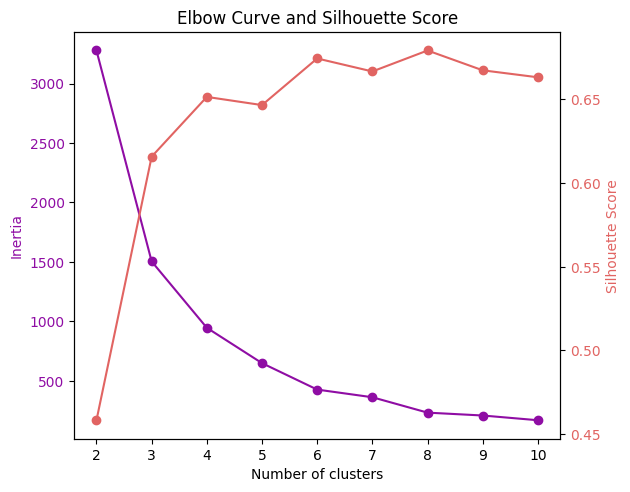

In [61]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib import cm

# Select numerical features for clustering
X = data[numerical_features]

# Determine the optimal number of clusters using the elbow method
inertia = []
silhouette_scores = []
range_n_clusters = range(2, 11)

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)
    silhouette_avg = silhouette_score(X, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)

# Plot the elbow curve and silhouette scores
fig, ax1 = plt.subplots()

ax1.set_xlabel('Number of clusters')
ax1.set_ylabel('Inertia', color=cm.plasma(0.3))
ax1.plot(range_n_clusters, inertia, 'o-', color=cm.plasma(0.3), label='Inertia')
ax1.tick_params(axis='y', labelcolor=cm.plasma(0.3))

ax2 = ax1.twinx()
ax2.set_ylabel('Silhouette Score', color=cm.plasma(0.6))
ax2.plot(range_n_clusters, silhouette_scores, 'o-', color=cm.plasma(0.6), label='Silhouette Score')
ax2.tick_params(axis='y', labelcolor=cm.plasma(0.6))
fig.tight_layout()
plt.title('Elbow Curve and Silhouette Score')
plt.show()

In [62]:
# Choose the optimal number of clusters
# Based on the elbow method, silhouette score, cluster-size balance, and on later evaluation of business context
optimal_clusters = 3 #range_n_clusters[np.argmax(silhouette_scores)]

# Fit the KMeans model
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
data['cluster'] = kmeans.fit_predict(X)

# Show the first few rows of the clustered dataset
data.head()

,npi,urbanity,countyname,Grouping_1,Classification_1,lat,long,provider_size,commercial_claims_ratio,medicaid_claims_ratio,...,standard_services_psychotherapy_claims_year,tele_services_psychotherapy_claims_year,total_other_payers_claims_year,total_commercial_claims_year,total_medicaid_claims_year,total_medicare_claims_year,standard_claims_ratio,tele_claims_ratio,psychotherapy_claims_ratio,cluster
3,1,Urban,Cumberland,Behavioral Health & Social Service Providers,Counselor,34.985025,-78.916585,Small,0.0,0.0,...,0,8,16,0,0,0,-0.292814,0.588235,0.227273,1
18,19,Urban,New Hanover,Behavioral Health & Social Service Providers,Clinical Neuropsychologist,34.240186,-77.945782,Small,0.0,0.0,...,5,2,0,0,0,0,-0.292814,-0.470588,-0.772727,2
23,24,Urban,Mecklenburg,Allopathic & Osteopathic Physicians,Pediatrics,35.197396,-80.836634,Small,0.0,0.0,...,2,3,25,0,0,0,-0.292814,-0.470588,-0.772727,2
25,26,Rural,Halifax,Behavioral Health & Social Service Providers,Counselor,36.431409,-77.652166,Small,0.0,0.0,...,4,0,0,0,0,0,-0.292814,-0.470588,-0.772727,2
27,28,Urban,Wake,Behavioral Health & Social Service Providers,Psychologist,35.833761,-78.619514,Small,0.0,0.0,...,4,0,19,0,0,0,-0.292814,-0.470588,-0.772727,2


In [63]:
# Save the clustered dataset to a CSV file, for further analysis and other uses
data.to_csv('clustered_dataset.csv', index=False)

### **Analyzing the Clusters**

Loading the data

In [64]:
# Load the clustered data results
file_path = 'clustered_dataset.csv'
c_data = pd.read_csv(file_path)

# Making sure that all values are there
print(c_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8920 entries, 0 to 8919
Data columns (total 30 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   npi                                          8920 non-null   int64  
 1   urbanity                                     8920 non-null   object 
 2   countyname                                   8920 non-null   object 
 3   Grouping_1                                   8920 non-null   object 
 4   Classification_1                             8920 non-null   object 
 5   lat                                          8920 non-null   float64
 6   long                                         8920 non-null   float64
 7   provider_size                                8920 non-null   object 
 8   commercial_claims_ratio                      8920 non-null   float64
 9   medicaid_claims_ratio                        8920 non-null   float64
 10  

Visualization

In [65]:
# Set a unified, consistent, and colorblind-friendly color palette for the plots
sns.set_palette('plasma')

C:\Users\harel\AppData\Local\Temp\ipykernel_5556\3061040533.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='cluster', data=c_data, palette=colors, dodge=False)


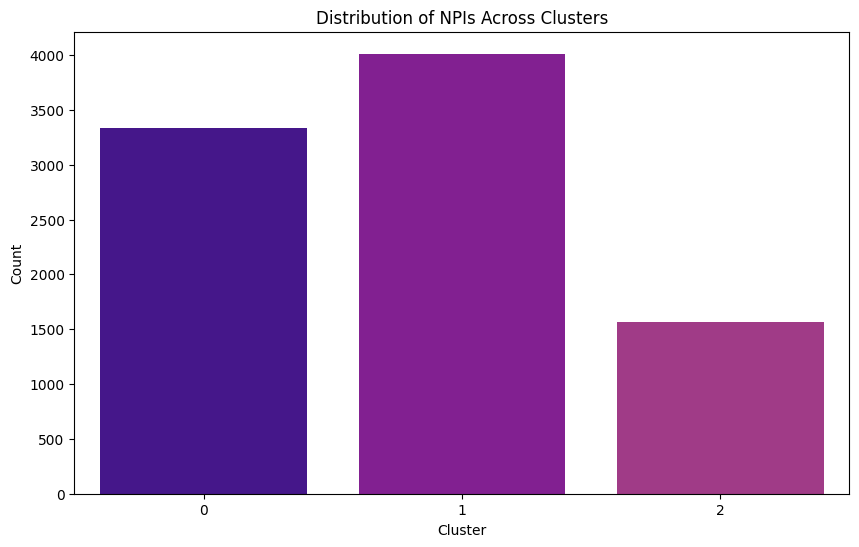

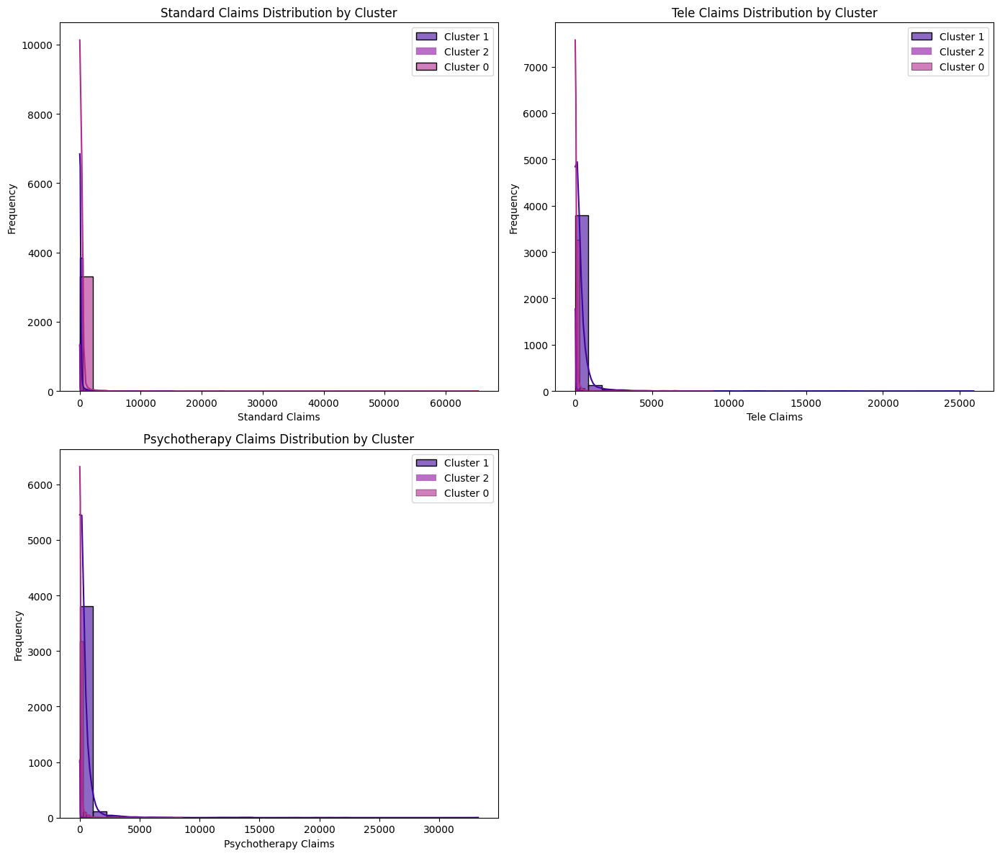

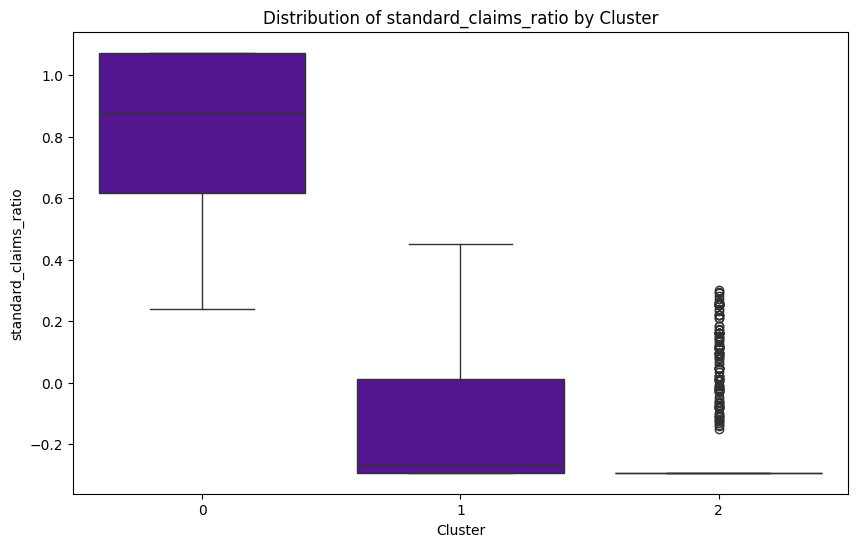

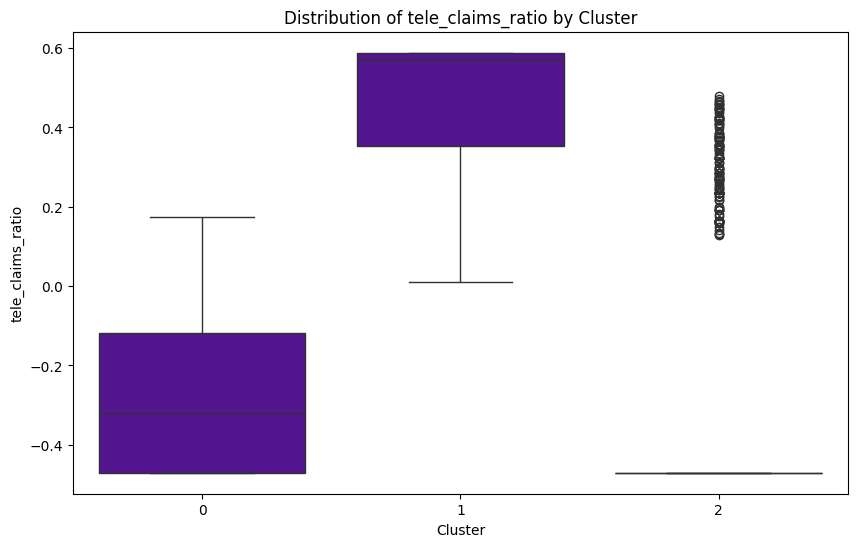

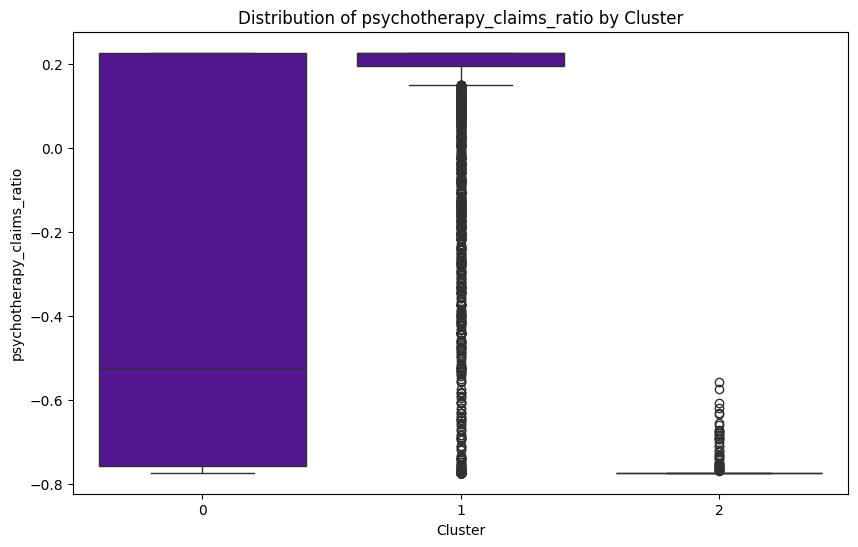


Statistical Summary for Cluster 1
               npi          lat         long  commercial_claims_ratio  \
count  4012.000000  4012.000000  4012.000000              4012.000000   
mean   4906.437936    35.499207   -79.843602                 0.005298   
std    2581.187451     0.518788     1.571597                 0.072589   
min       1.000000    33.894008   -84.029432                 0.000000   
25%    2868.250000    35.188554   -80.841079                 0.000000   
50%    4935.500000    35.585693   -79.666238                 0.000000   
75%    7252.250000    35.910568   -78.707792                 0.000000   
max    8919.000000    36.527295   -75.640223                 2.800000   

       medicaid_claims_ratio  medicare_claims_ratio  other_claims_ratio  \
count            4012.000000            4012.000000         4012.000000   
mean                0.013933               0.002941            0.508196   
std                 0.665770               0.070206            3.007679   
min    

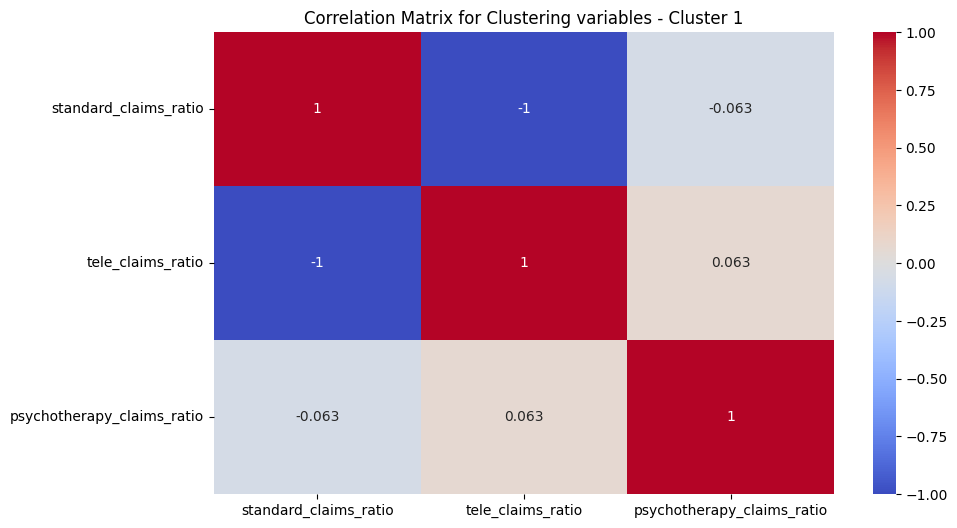

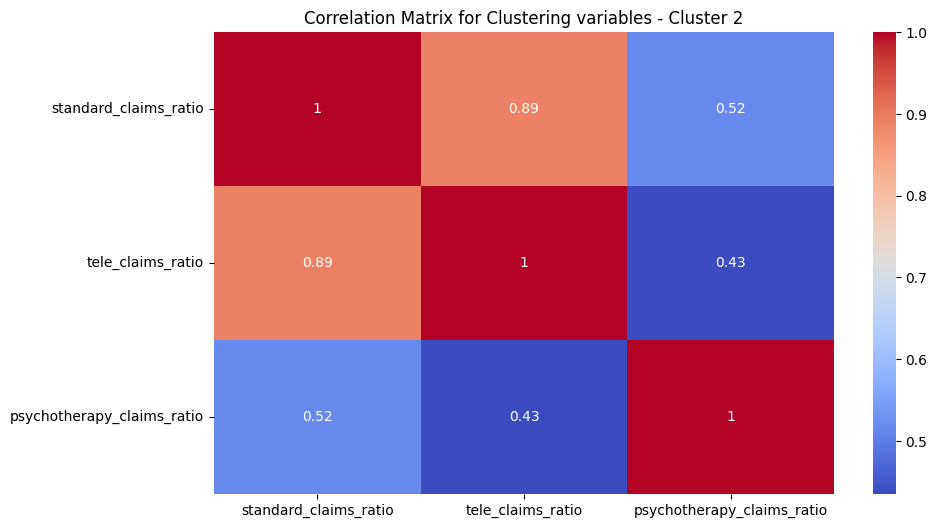

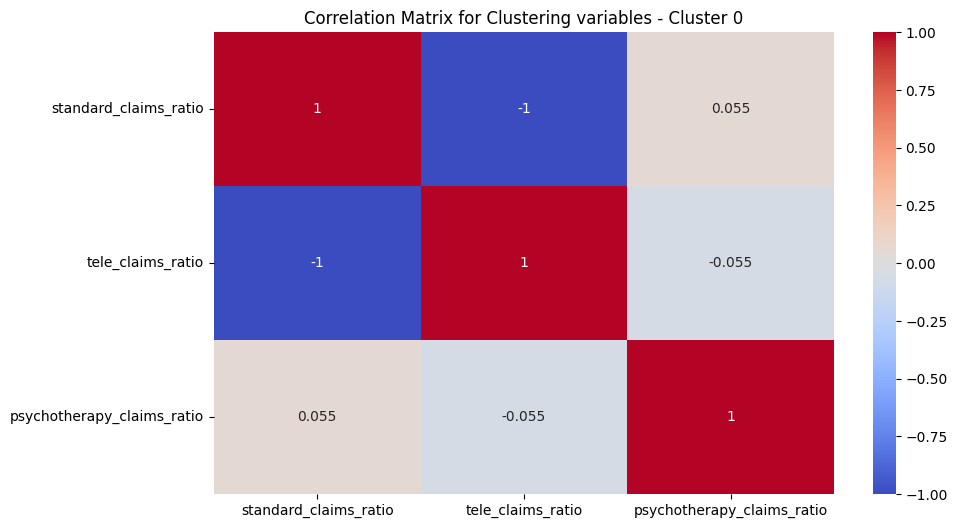

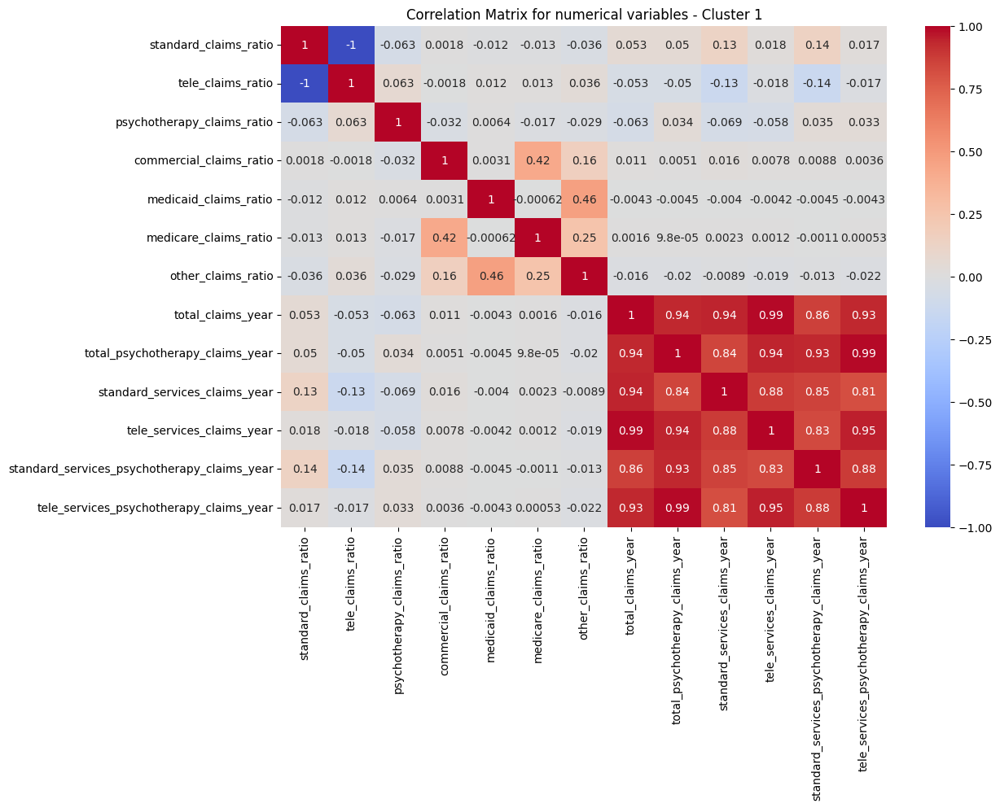

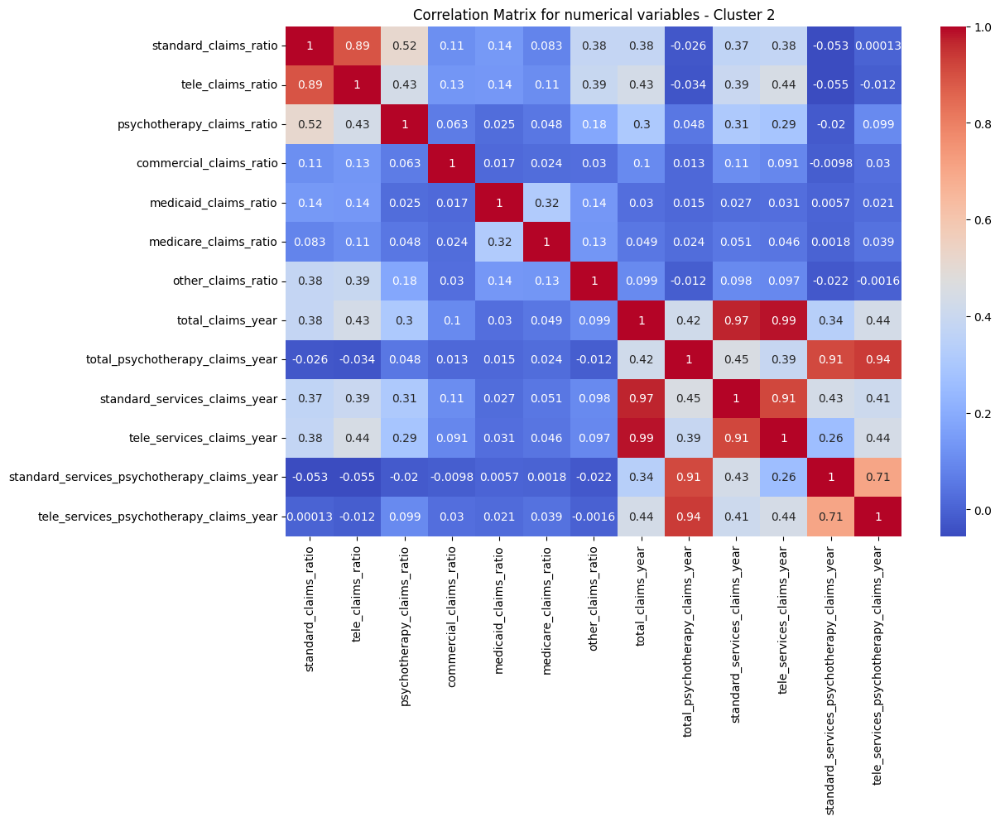

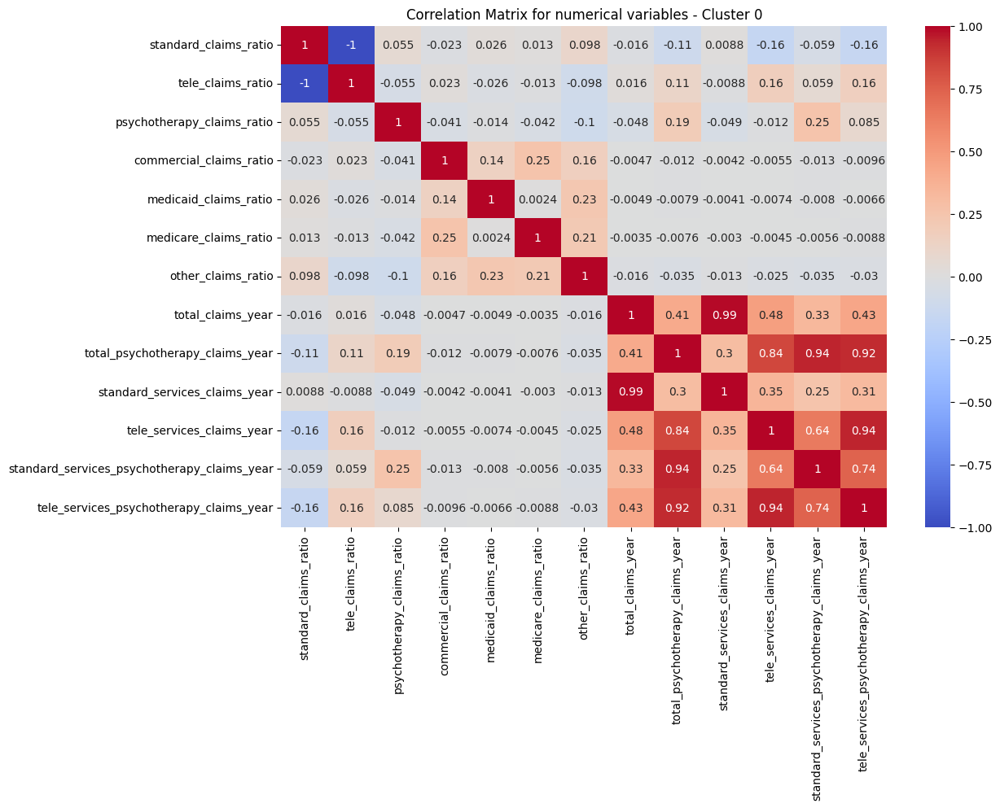

In [66]:
# Define a colormap and specific colors for each cluster from 'plasma'
colormap = plt.get_cmap('plasma')
colors = [colormap(0.1), colormap(0.3), colormap(0.4)]  # Plasma colors for clusters 0, 1, and 2

# Visualize the distribution of clusters
plt.figure(figsize=(10, 6))
sns.countplot(x='cluster', data=c_data, palette=colors, dodge=False)
plt.title('Distribution of NPIs Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

# Create a 2x2 plot for standard, tele, and psychotherapy claims for all clusters
clusters = c_data['cluster'].unique()

plt.figure(figsize=(14, 12))

# Standard Claims Ratio
plt.subplot(2, 2, 1)
for i, cluster in enumerate(clusters):
    cluster_data = c_data[c_data['cluster'] == cluster]
    sns.histplot(cluster_data['standard_services_claims_year'], kde=True, bins=30, label=f'Cluster {cluster}', color=colors[i], alpha=0.6)
plt.title('Standard Claims Distribution by Cluster')
plt.xlabel('Standard Claims')
plt.ylabel('Frequency')
plt.legend()

# Tele Claims Ratio
plt.subplot(2, 2, 2)
for i, cluster in enumerate(clusters):
    cluster_data = c_data[c_data['cluster'] == cluster]
    sns.histplot(cluster_data['tele_services_claims_year'], kde=True, bins=30, label=f'Cluster {cluster}', color=colors[i], alpha=0.6)
plt.title('Tele Claims Distribution by Cluster')
plt.xlabel('Tele Claims')
plt.ylabel('Frequency')
plt.legend()

# Psychotherapy Claims Ratio
plt.subplot(2, 2, 3)
for i, cluster in enumerate(clusters):
    cluster_data = c_data[c_data['cluster'] == cluster]
    sns.histplot(cluster_data['total_psychotherapy_claims_year'], kde=True, bins=30, label=f'Cluster {cluster}', color=colors[i], alpha=0.6)
plt.title('Psychotherapy Claims Distribution by Cluster')
plt.xlabel('Psychotherapy Claims')
plt.ylabel('Frequency')
plt.legend()

plt.tight_layout()
plt.show()

# Other visualizations would follow similar pattern using colors[i] for each cluster

# Feature distributions for each cluster
features = numerical_features

for feature in features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=feature, data=c_data)
    plt.title(f'Distribution of {feature} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()

# Statistical Summaries
for cluster_id in c_data['cluster'].unique():
    print(f"\nStatistical Summary for Cluster {cluster_id}")
    cluster_c_data = c_data[c_data['cluster'] == cluster_id]
    print(cluster_c_data.describe())

# correlation matrix only for clustering variables
for cluster_id in c_data['cluster'].unique():
    cluster_c_data = c_data[c_data['cluster'] == cluster_id]
    corr = cluster_c_data[numerical_features].corr()
    plt.figure(figsize=(10, 6))
    sns.heatmap(corr, annot=True, cmap='coolwarm')
    plt.title(f'Correlation Matrix for Clustering variables - Cluster {cluster_id}')
    plt.show()

# Explore correlations within clusters for numerical features
corr_numeric_features =  [
                        'standard_claims_ratio', 'tele_claims_ratio', 'psychotherapy_claims_ratio', 'commercial_claims_ratio', 'medicaid_claims_ratio', 'medicare_claims_ratio','other_claims_ratio',
                        'total_claims_year', 'total_psychotherapy_claims_year', 'standard_services_claims_year', 'tele_services_claims_year', 'standard_services_psychotherapy_claims_year', 'tele_services_psychotherapy_claims_year',
                          ]
for cluster_id in c_data['cluster'].unique():
    plt.figure(figsize=(12, 8))
    cluster_c_data = c_data[c_data['cluster'] == cluster_id]
    corr = cluster_c_data[corr_numeric_features].corr()
    sns.heatmap(corr, annot=True, cmap='coolwarm')
    plt.title(f'Correlation Matrix for numerical variables - Cluster {cluster_id}')
    plt.show()

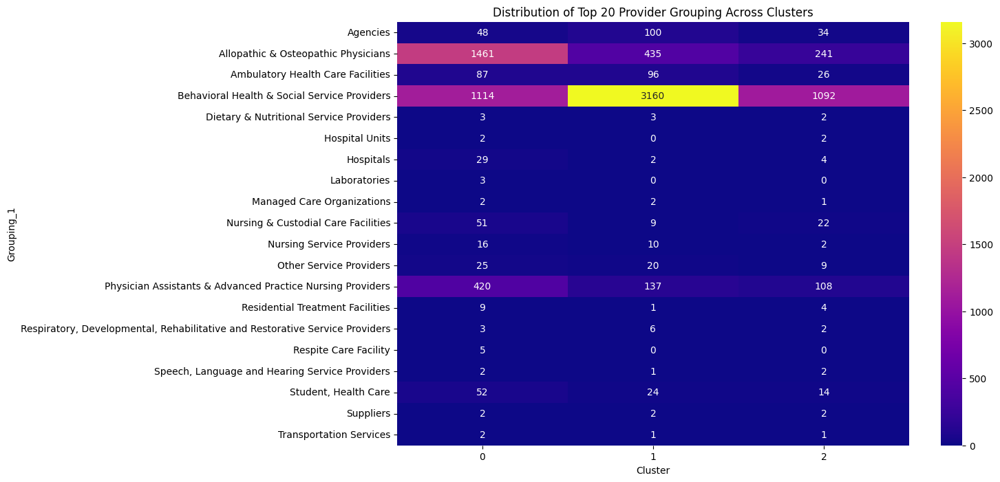

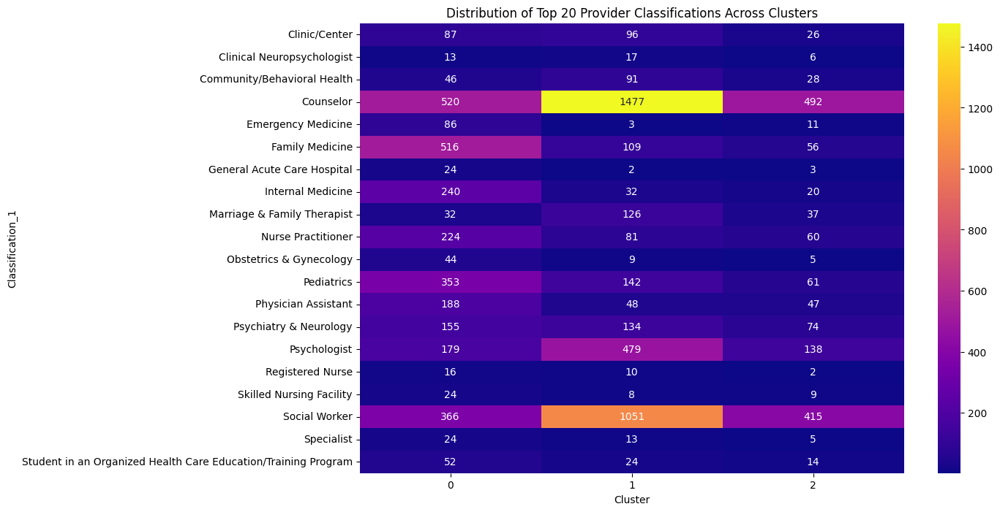

(cluster                                                  0       1       2
 Grouping_1                                                                
 Agencies                                              48.0   100.0    34.0
 Allopathic & Osteopathic Physicians                 1461.0   435.0   241.0
 Ambulatory Health Care Facilities                     87.0    96.0    26.0
 Behavioral Health & Social Service Providers        1114.0  3160.0  1092.0
 Dietary & Nutritional Service Providers                3.0     3.0     2.0
 Hospital Units                                         2.0     0.0     2.0
 Hospitals                                             29.0     2.0     4.0
 Laboratories                                           3.0     0.0     0.0
 Managed Care Organizations                             2.0     2.0     1.0
 Nursing & Custodial Care Facilities                   51.0     9.0    22.0
 Nursing Service Providers                             16.0    10.0     2.0
 Other Servi

In [67]:
# Get the top 20 Grouping and Classification based on their counts in providers
top_20_grouping = c_data['Grouping_1'].value_counts().index[:20]
top_20_classification = c_data['Classification_1'].value_counts().index[:20]

# Filter the dataset to include only the top 20 Grouping_1 and Classification_1
c_data_top_grouping = c_data[c_data['Grouping_1'].isin(top_20_grouping)]
c_data_top_classification = c_data[c_data['Classification_1'].isin(top_20_classification)]

# Analyze the distribution of top 20 Grouping_1 and Classification_1 across clusters
grouping_cluster_dist_top = c_data_top_grouping.groupby(['cluster', 'Grouping_1']).size().unstack().fillna(0)
classification_cluster_dist_top = c_data_top_classification.groupby(['cluster', 'Classification_1']).size().unstack().fillna(0)

# Transpose the distributions for better visualization
grouping_cluster_dist_top_transposed = grouping_cluster_dist_top.T
classification_cluster_dist_top_transposed = classification_cluster_dist_top.T

# Visualize the transposed distribution of top 20 Grouping_1 across clusters
plt.figure(figsize=(12, 8))
sns.heatmap(grouping_cluster_dist_top_transposed, annot=True, fmt='g', cmap='plasma')
plt.title('Distribution of Top 20 Provider Grouping Across Clusters')
plt.ylabel('Grouping_1')
plt.xlabel('Cluster')
plt.show()

# Visualize the transposed distribution of top 20 Classification_1 across clusters
plt.figure(figsize=(12, 8))
sns.heatmap(classification_cluster_dist_top_transposed, annot=True, fmt='g', cmap='plasma')
plt.title('Distribution of Top 20 Provider Classifications Across Clusters')
plt.ylabel('Classification_1')
plt.xlabel('Cluster')
plt.show()

grouping_cluster_dist_top_transposed, classification_cluster_dist_top_transposed


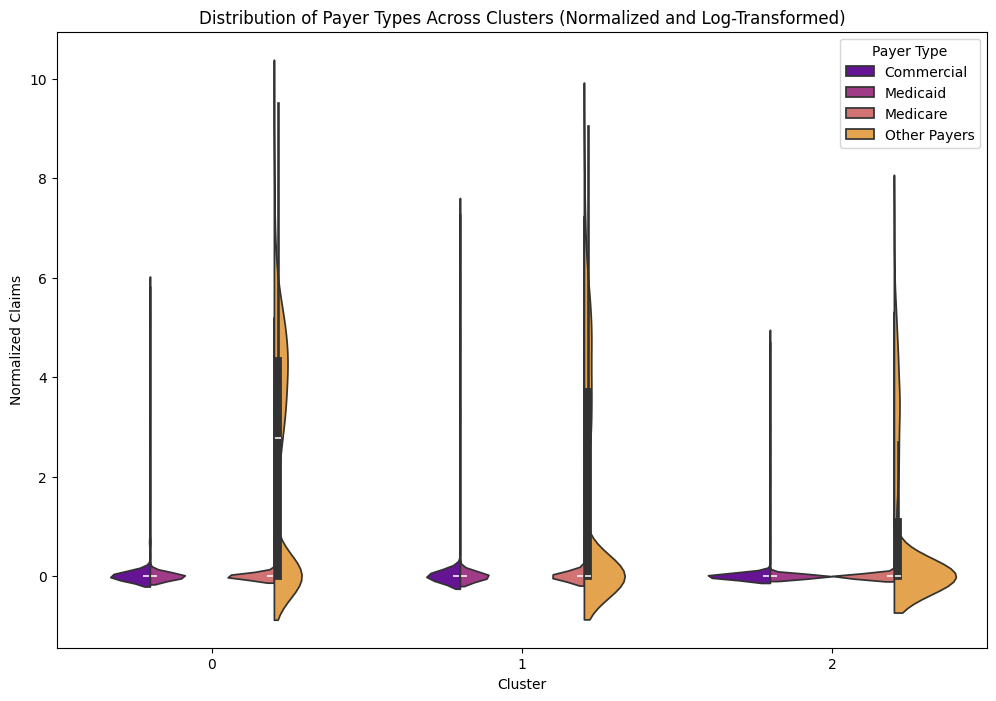

In [68]:
# Prepare data for visualization
payer_columns = ['total_commercial_claims_year', 'total_medicaid_claims_year', 'total_medicare_claims_year', 'total_other_payers_claims_year']
payer_data = c_data.melt(id_vars=['cluster'], value_vars=payer_columns, var_name='Payer Type', value_name='Claims')

# Rename payer types for better readability
payer_data['Payer Type'] = payer_data['Payer Type'].str.replace('total_', '').str.replace('_claims_year', '').str.replace('_', ' ').str.title()

# Apply robust scaling to handle outliers and zeros
scaler = RobustScaler()
payer_data['Scaled Claims'] = scaler.fit_transform(payer_data[['Claims']])

# Apply log transformation to further normalize the values
payer_data['Normalized Claims'] = np.log1p(payer_data['Scaled Claims'])

# Create a violin plot for the distribution of payer types across clusters
plt.figure(figsize=(12, 8))
sns.violinplot(x='cluster', y='Normalized Claims', hue='Payer Type', data=payer_data, palette='plasma', split=True)
plt.title('Distribution of Payer Types Across Clusters (Normalized and Log-Transformed)')
plt.xlabel('Cluster')
plt.ylabel('Normalized Claims')
plt.legend(title='Payer Type')
plt.show()

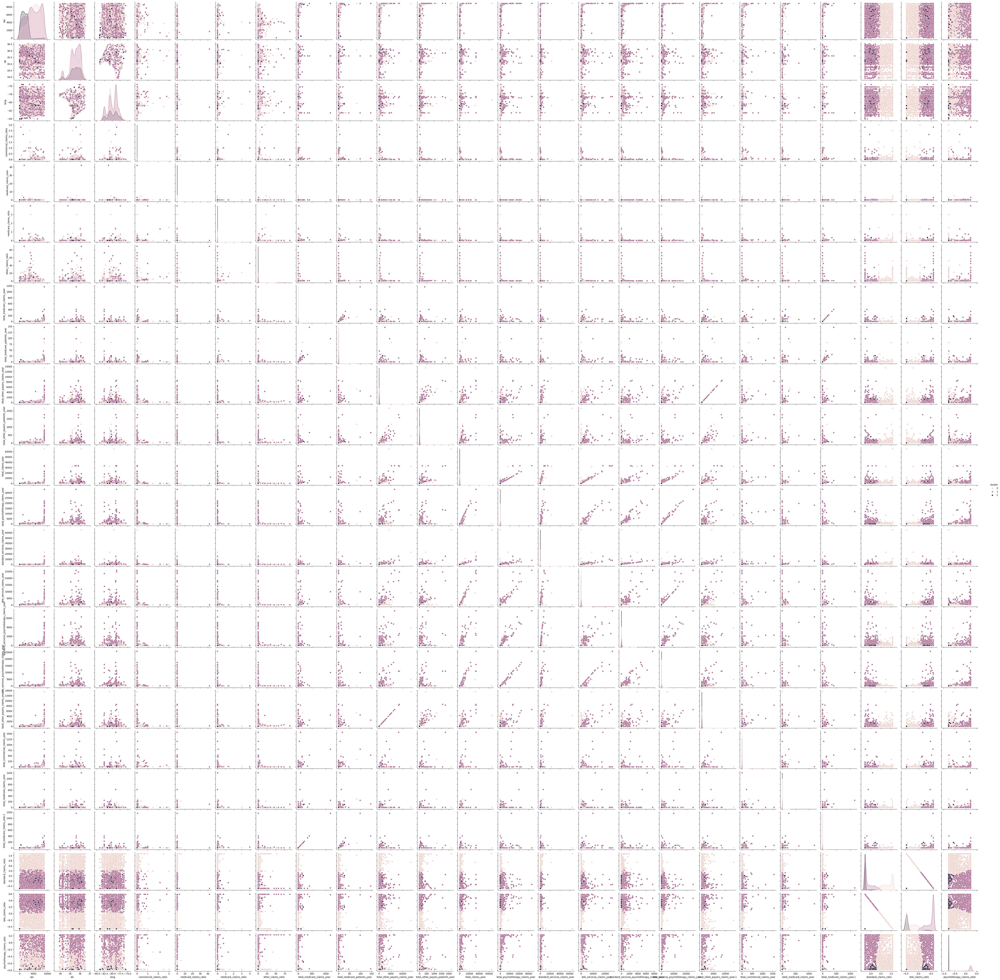

In [69]:
# Pairplot to visualize relationships between features in each cluster
sns.pairplot(c_data, hue='cluster', diag_kind='kde')
plt.show()

In [71]:
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

# Create a base map centered around North Carolina
m = folium.Map(location=[35.5, -79.0], zoom_start=6)

# Define the colormap
colormap = cm.get_cmap('plasma', c_data['cluster'].nunique())
norm = colors.Normalize(vmin=c_data['cluster'].min(), vmax=c_data['cluster'].max())

# Add points to the map
for idx, row in c_data.iterrows():
    folium.CircleMarker(
        location=(row['lat'], row['long']),
        radius=5,
        color=colors.rgb2hex(colormap(norm(row['cluster']))),
        fill=True,
        fill_color=colors.rgb2hex(colormap(norm(row['cluster']))),
        fill_opacity=0.6,
        popup=f'NPI: {row["npi"]}<br>Cluster: {row["cluster"]}'
    ).add_to(m)

# Add colormap legend
colormap = folium.StepColormap(
    colors=[colors.rgb2hex(colormap(i)) for i in range(colormap.N)],
    vmin=c_data['cluster'].min(),
    vmax=c_data['cluster'].max(),
    caption='Cluster'
)
colormap.add_to(m)

# Display the map
m


C:\Users\harel\AppData\Local\Temp\ipykernel_5556\2295702229.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap('plasma', c_data['cluster'].nunique())
